![](https://www.ieseg.fr/wp-content/uploads/IESEG-Logo-2012-rgb.jpg)

## CREDIT SCORING INDIVIDUAL ASSIGNMENT
## STUDENT - NITHESH RAMANNA

In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from collections import defaultdict

from sklearn.linear_model    import LogisticRegression
from sklearn.metrics         import *
from sklearn.model_selection import GridSearchCV, train_test_split
import seaborn as sns
# import module
from Binning import WOE
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.inspection import permutation_importance
import warnings
warnings.filterwarnings('ignore')
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier 
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier

C:\tools\Anaconda3\envs\py\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
C:\tools\Anaconda3\envs\py\lib\site-packages\numpy\.libs\libopenblas.EL2C6PLE4ZYW3ECEVIV3OXXGRN2NRFM2.gfortran-win_amd64.dll
C:\tools\Anaconda3\envs\py\lib\site-packages\numpy\.libs\libopenblas.WCDJNK7YVMPZQ2ME2ZZHJJRJ3JIKNDB7.gfortran-win_amd64.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


In [2]:
# Read datasets
accept = pd.read_csv('./Assignment2022_Data/RealEstateLoans_accepts.csv')
reject = pd.read_csv('./Assignment2022_Data/RealEstateLoans_rejects.csv')

In [3]:
accept.head()

,total_income,loan_amount,term,interest_rate,own_car,own_house,nr_children,income_type,education_type,family_status,...,occupation_type,family_count,EXT1,EXT2,EXT3,EXT4,EXT5,EXT6,EXT7,Default
0,157500.0,288562.5,30,3.737395,Y,N,0,Commercial associate,Secondary / secondary special,Married,...,Drivers,2.0,NaN,0.541308,0.236611,0,0,0,0,0
1,76500.0,225000.0,48,3.654300,N,Y,3,Working,Secondary / secondary special,Separated,...,Laborers,4.0,NaN,0.395423,0.673830,0,1,0,0,0
2,67500.0,409653.0,12,3.262865,Y,N,0,Working,Secondary / secondary special,Civil marriage,...,Laborers,2.0,NaN,0.649417,0.042929,0,1,0,0,1
3,180000.0,328405.5,24,4.773736,Y,N,1,Working,Secondary / secondary special,Separated,...,Laborers,2.0,0.512811,0.337838,0.852828,0,1,0,0,0
4,130500.0,1225224.0,60,2.867961,N,N,0,Pensioner,Secondary / secondary special,Married,...,NaN,2.0,0.595440,0.537174,0.367291,0,0,0,0,0


In [4]:
reject.head()

,total_income,loan_amount,term,interest_rate,own_car,own_house,nr_children,income_type,education_type,family_status,...,days_phone_change,occupation_type,family_count,EXT1,EXT2,EXT3,EXT4,EXT5,EXT6,EXT7
0,270000.0,888840.0,48,2.344399,N,Y,1,Commercial associate,Higher education,Married,...,-1866.0,Core staff,3.0,NaN,0.409056,0.687933,0,1,0,0
1,90000.0,562491.0,36,3.195584,N,Y,0,Working,Secondary / secondary special,Married,...,-1821.0,Laborers,2.0,0.398079,0.693795,0.563835,0,1,0,0
2,225000.0,790830.0,48,3.156887,Y,Y,0,Working,Secondary / secondary special,Single / not married,...,0.0,Laborers,1.0,0.023845,0.420569,0.692559,0,1,0,0
3,135000.0,900000.0,42,3.472026,N,N,0,Commercial associate,Secondary / secondary special,Married,...,-1068.0,Sales staff,2.0,NaN,0.108418,0.441836,0,0,0,1
4,67500.0,808650.0,24,2.610668,N,N,0,Pensioner,Secondary / secondary special,Single / not married,...,-488.0,NaN,1.0,NaN,0.508502,0.771362,0,1,0,0


In [5]:
accept.isna().sum()

total_income                   0
loan_amount                    0
term                           0
interest_rate                  0
own_car                        0
own_house                      0
nr_children                    0
income_type                    0
education_type                 0
family_status                  0
housing_type                   0
region_population_ratio        0
days_birth                     0
days_employed                  0
days_registration              0
mobile_number                  0
phone_number                   0
email                          0
days_phone_change              0
occupation_type             5922
family_count                   0
EXT1                       10415
EXT2                          33
EXT3                        3640
EXT4                           0
EXT5                           0
EXT6                           0
EXT7                           0
Default                        0
dtype: int64

In [6]:
reject.isna().sum()

total_income                  0
loan_amount                   0
term                          0
interest_rate                 0
own_car                       0
own_house                     0
nr_children                   0
income_type                   0
education_type                0
family_status                 0
housing_type                  0
region_population_ratio       0
days_birth                    0
days_employed                 0
days_registration             0
mobile_number                 0
phone_number                  0
email                         0
days_phone_change             0
occupation_type            2751
family_count                  0
EXT1                       5273
EXT2                         16
EXT3                       1812
EXT4                          0
EXT5                          0
EXT6                          0
EXT7                          0
dtype: int64

In [7]:
# fill Na's EXT2 and EXT3 with median 
accept['EXT2'] = accept.EXT2.fillna(accept.EXT2.median())
reject['EXT2'] = reject.EXT2.fillna(accept.EXT2.median())
accept['EXT3'] = accept.EXT3.fillna(accept.EXT3.median())
reject['EXT3'] = reject.EXT3.fillna(accept.EXT3.median())

In [8]:
# removing the EXT1 as it has high number of NA's
accept = accept.drop(columns = ['EXT1'], axis = 1)
reject = reject.drop(columns = ['EXT1'], axis = 1)

In [9]:
accept.dtypes

total_income               float64
loan_amount                float64
term                         int64
interest_rate              float64
own_car                     object
own_house                   object
nr_children                  int64
income_type                 object
education_type              object
family_status               object
housing_type                object
region_population_ratio    float64
days_birth                   int64
days_employed                int64
days_registration          float64
mobile_number                int64
phone_number                 int64
email                        int64
days_phone_change          float64
occupation_type             object
family_count               float64
EXT2                       float64
EXT3                       float64
EXT4                         int64
EXT5                         int64
EXT6                         int64
EXT7                         int64
Default                      int64
dtype: object

## EXPLORATORY DATA ANALYSIS

In [10]:
# Class distribution
labels = ["Default - 0", "Default - 1"]
values = np.bincount(accept['Default'])

print(accept[accept.columns[~accept.columns.isin(['Default'])]].shape, accept['Default'].shape)
print(np.bincount(accept['Default']))

donut = go.Figure(data=[go.Pie(labels=labels, values=values, hole=.5, marker_colors=["rgb(153, 214, 255)", "rgb(0, 92, 153)"])])
donut.show()

(18549, 27) (18549,)
[16964  1585]


### There are 8.54 percent of defaulters in the accept data set

## Numerical Variables

In [11]:
cols = ['total_income', 'loan_amount', 'term', 'interest_rate',
        'nr_children',   'region_population_ratio', 'days_birth',
       'days_employed', 'days_registration', 'family_count', 'EXT2', 
        'EXT3']

In [12]:
# Data exploration: Boxplots (seperated by value ranges)
fig = go.Figure()

for col in cols:
    fig.add_trace(go.Box(x=accept[col], name=col))
fig.show()

In [13]:
# Data exploration: Boxplots (seperated by value ranges)
fig = go.Figure()

for col in cols:
    fig.add_trace(go.Box(x=reject[col], name=col))
fig.show()

### Looking at the box plots for both accept and reject data we can see lot of outliers in loan amount and total income and one outlier in days_employed

<AxesSubplot:xlabel='loan_amount', ylabel='Count'>

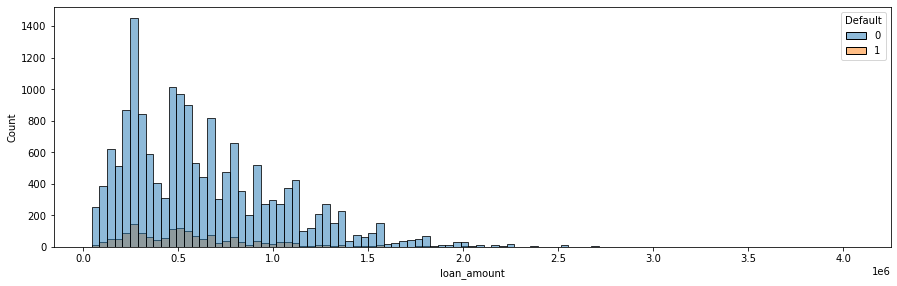

In [14]:
# Distribution of loan amount in accept dataset
plt.figure(figsize=(15,15))
plt.subplot(3, 1, 1) 
sns.histplot(data=accept, x="loan_amount", hue = 'Default')

<AxesSubplot:xlabel='total_income', ylabel='Count'>

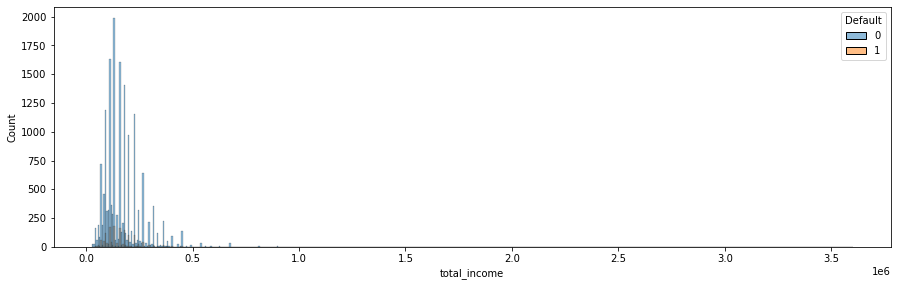

In [15]:
# Distribution of total income in accept dataset
plt.figure(figsize=(15,15))
plt.subplot(3, 1, 1) 
sns.histplot(data=accept, x="total_income", hue = 'Default')

<AxesSubplot:xlabel='days_employed', ylabel='Count'>

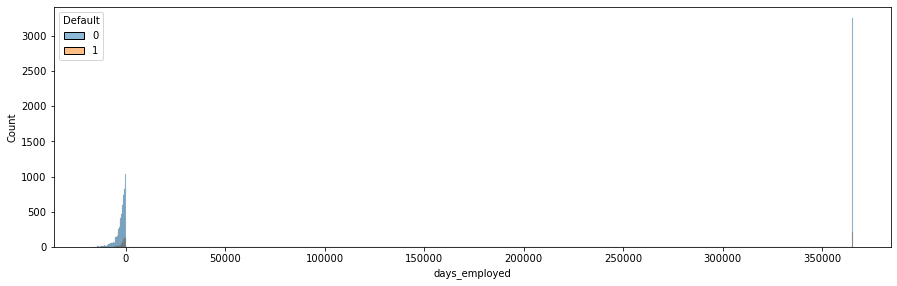

In [16]:
# Distribution of days employed in accept dataset
plt.figure(figsize=(15,15))
plt.subplot(3, 1, 1) 
sns.histplot(data=accept, x="days_employed", hue = 'Default')

<AxesSubplot:xlabel='days_employed', ylabel='Count'>

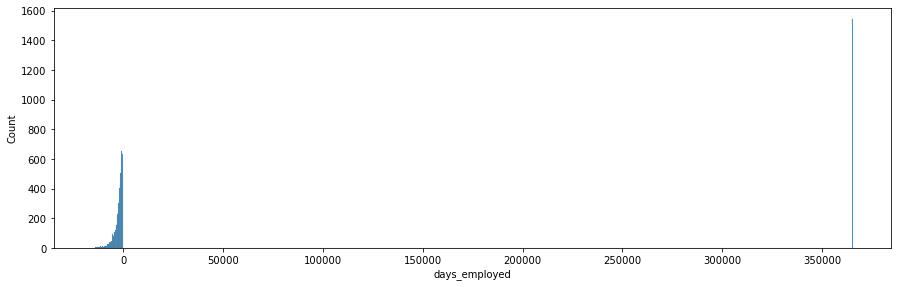

In [17]:
# Distribution of days employed in reject dataset
plt.figure(figsize=(15,15))
plt.subplot(3, 1, 1) 
sns.histplot(data=reject, x="days_employed")

<AxesSubplot:xlabel='interest_rate', ylabel='Count'>

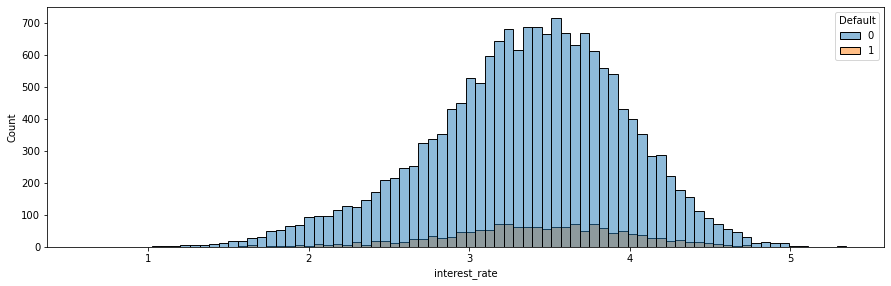

In [18]:
# Distribution of days employed in reject dataset
plt.figure(figsize=(15,15))
plt.subplot(3, 1, 1) 
sns.histplot(data=accept, x="interest_rate", hue = 'Default')

<AxesSubplot:xlabel='term', ylabel='Count'>

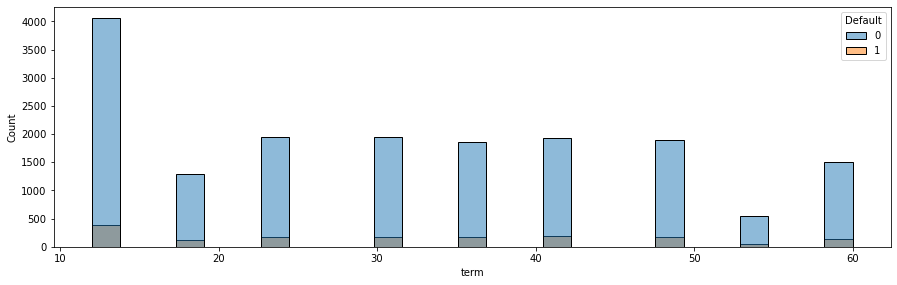

In [19]:
# Distribution of days employed in reject dataset
plt.figure(figsize=(15,15))
plt.subplot(3, 1, 1) 
sns.histplot(data=accept, x="term", hue = 'Default')

<AxesSubplot:xlabel='nr_children', ylabel='Count'>

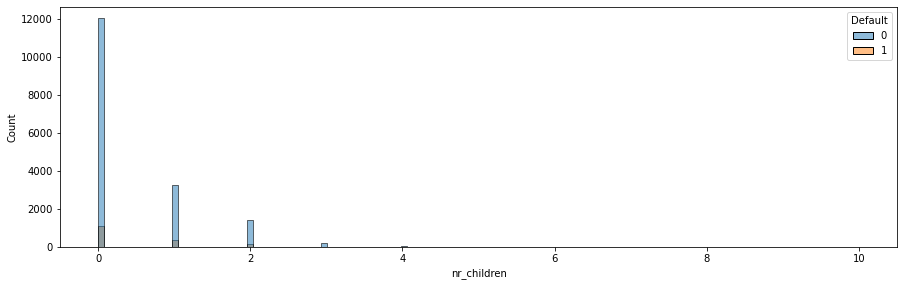

In [20]:
# Distribution of days employed in reject dataset
plt.figure(figsize=(15,15))
plt.subplot(3, 1, 1) 
sns.histplot(data=accept, x="nr_children", hue = 'Default')

<AxesSubplot:xlabel='region_population_ratio', ylabel='Count'>

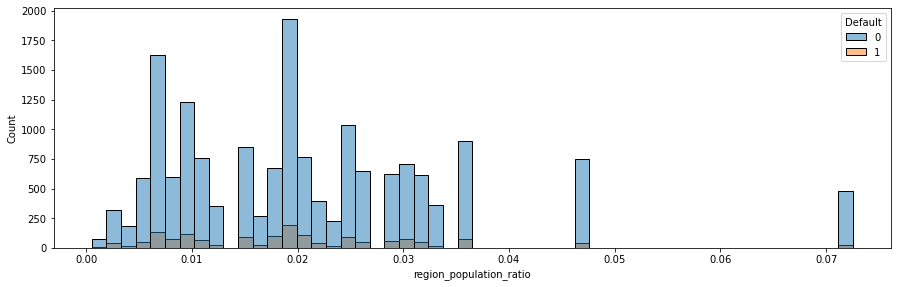

In [21]:
# Distribution of region_population_ratio in reject dataset
plt.figure(figsize=(15,15))
plt.subplot(3, 1, 1) 
sns.histplot(data=accept, x="region_population_ratio", hue = 'Default')

<AxesSubplot:xlabel='days_birth', ylabel='Count'>

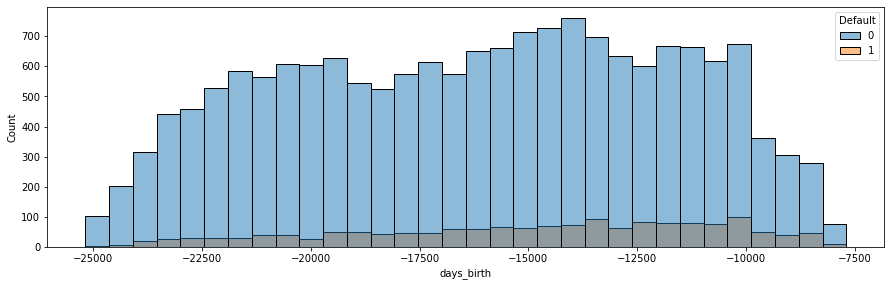

In [22]:
# Distribution of days_birth in reject dataset
plt.figure(figsize=(15,15))
plt.subplot(3, 1, 1) 
sns.histplot(data=accept, x="days_birth", hue = 'Default')

<AxesSubplot:xlabel='days_registration', ylabel='Count'>

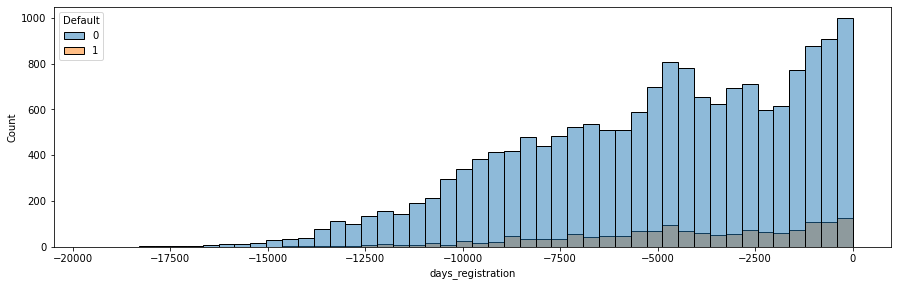

In [23]:
# Distribution of days registration in reject dataset
plt.figure(figsize=(15,15))
plt.subplot(3, 1, 1) 
sns.histplot(data=accept, x="days_registration", hue = 'Default')

<AxesSubplot:xlabel='family_count', ylabel='Count'>

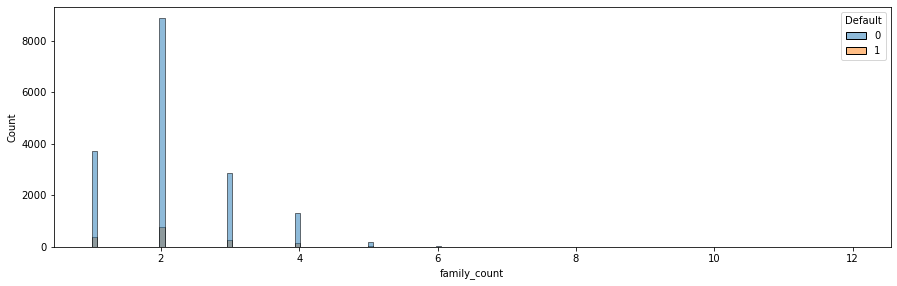

In [24]:
# Distribution of family count in reject dataset
plt.figure(figsize=(15,15))
plt.subplot(3, 1, 1) 
sns.histplot(data=accept, x="family_count", hue = 'Default')

<AxesSubplot:xlabel='EXT2', ylabel='Count'>

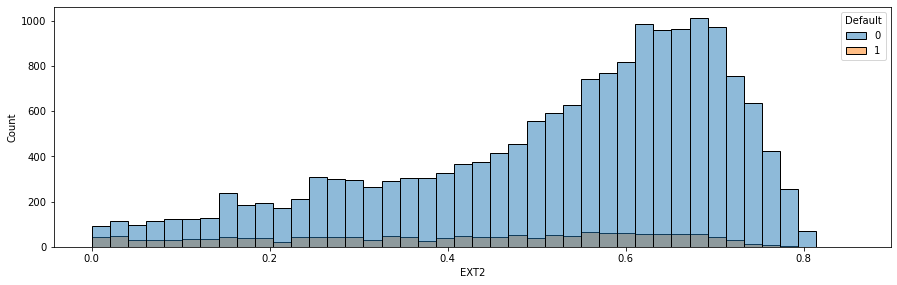

In [25]:
# Distribution of EXT2 in reject dataset
plt.figure(figsize=(15,15))
plt.subplot(3, 1, 1) 
sns.histplot(data=accept, x="EXT2", hue = 'Default')

<AxesSubplot:xlabel='EXT3', ylabel='Count'>

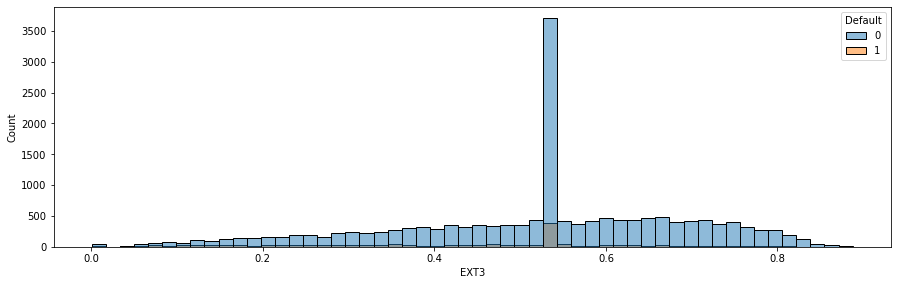

In [26]:
# Distribution of EXT2 in reject dataset
plt.figure(figsize=(15,15))
plt.subplot(3, 1, 1) 
sns.histplot(data=accept, x="EXT3", hue = 'Default')

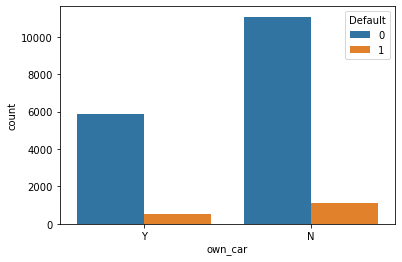

In [27]:
# Distribution of defaults for people with car or without car
ax = sns.countplot(x="own_car", hue="Default", data=accept)

More defaulters are among customers who have no car

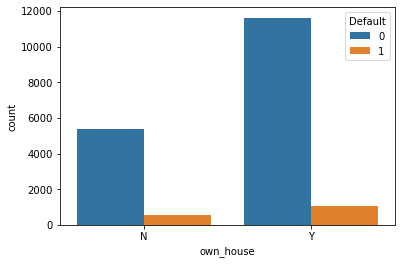

In [28]:
# Distribution of defaults for people with house or without house
ax = sns.countplot(x="own_house", hue="Default", data=accept)

More defaulters are among customers who have house

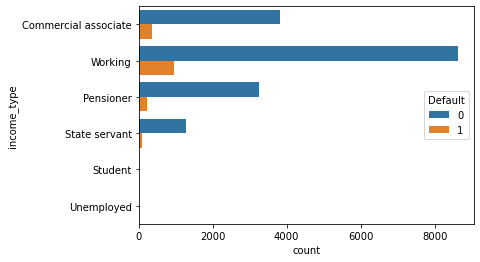

In [29]:
# Distribution of defaults for people with house or without house
ax = sns.countplot(y="income_type", hue="Default", data=accept)

More defaulters are among Working customers

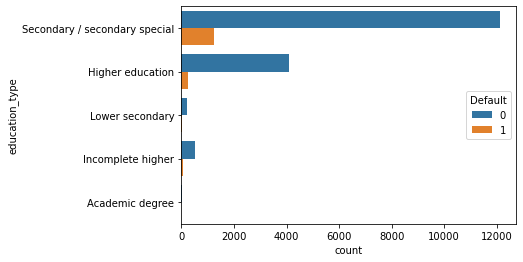

In [30]:
# Distribution of defaults for people with house or without house
ax = sns.countplot(y="education_type", hue="Default", data=accept)

More defaulters among customers who have secondary education

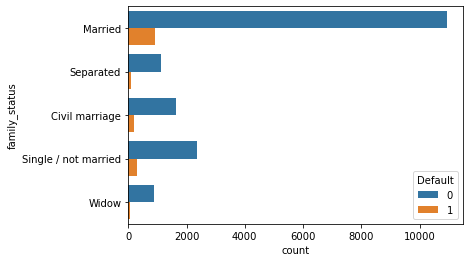

In [31]:
# Distribution of defaults for family status
ax = sns.countplot(y="family_status", hue="Default", data=accept)

More defaulters among Married customers 

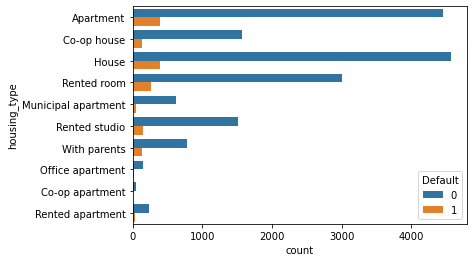

In [32]:
# Distribution of defaults for family status
ax = sns.countplot(y="housing_type", hue="Default", data=accept)

More defaulters among people who live in Appartment, House and rented room

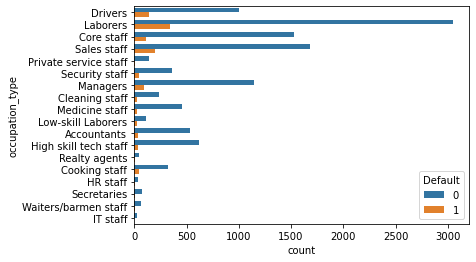

In [33]:
# Distribution of defaults for family status
ax = sns.countplot(y="occupation_type", hue="Default", data=accept)

More defaulters among people who are laborers followed by Sales staff, Drivers, core staff

## Winsorized
### Looking at hisplot for the numerical variables, I decieded to winsorize 'total_income', 'loan_amount' and days_employed variable. 
### Winsorization is the transformation of statistics by limiting extreme values in the statistical data to reduce the effect of possibly spurious outliers
https://en.wikipedia.org/wiki/Winsorizing

In [34]:
from scipy import stats
# 5% winsorization (2-sided -> 2.5% bottom, 97.5% top)
cols = ['total_income', 'loan_amount', 'days_employed']
perc = 0.05

# winsorize column
accept[cols] = accept[cols].apply(stats.mstats.winsorize, limits=(perc/2, perc/2))

In [35]:
# 5% winsorization (2-sided -> 2.5% bottom, 97.5% top)
perc = 0.05

# winsorize column
reject[cols] = reject[cols].apply(stats.mstats.winsorize, limits=(perc/2, perc/2))

In [36]:
# Label encoding all the categorical variables by creating 
# new object of label endcoder for each variable and appling 
# the encoding on both accept and reject. Creating the new object
# for each variable because it helps in inversing the encoded values

from sklearn.preprocessing import LabelEncoder
le1 = LabelEncoder()
le1.fit(accept['own_car'])
accept['own_car'] = le1.transform(accept['own_car'])
reject['own_car'] = le1.transform(reject['own_car'])

le2 = LabelEncoder()
le2.fit(accept['own_house'])
accept['own_house'] = le2.transform(accept['own_house'])
reject['own_house'] = le2.transform(reject['own_house'])

le3 = LabelEncoder()
le3.fit(accept['income_type'])
accept['income_type'] = le3.transform(accept['income_type'])
reject['income_type'] = le3.transform(reject['income_type'])

le4 = LabelEncoder()
le4.fit(accept['education_type'])
accept['education_type'] = le4.transform(accept['education_type'])
reject['education_type'] = le4.transform(reject['education_type'])

le5 = LabelEncoder()
le5.fit(accept['family_status'])
accept['family_status'] = le5.transform(accept['family_status'])
reject['family_status'] = le5.transform(reject['family_status'])

le6 = LabelEncoder()
le6.fit(accept['housing_type'])
accept['housing_type'] = le6.transform(accept['housing_type'])
reject['housing_type'] = le6.transform(reject['housing_type'])

le7 = LabelEncoder()
le7.fit(accept['occupation_type'])
accept['occupation_type'] = le7.transform(accept['occupation_type'])
reject['occupation_type'] = le7.transform(reject['occupation_type'])

## Modeling

### Fitting Logistic Regression, Decission Tree and Random Forest on accept set and choosing the best model 

In [37]:
# train test split
X = accept[accept.columns[~accept.columns.isin(['Default'])]]
y = accept['Default']

#Split data in train (80%), test (40%)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, stratify = y, random_state=42)

#Split test in test (20%), validation (20%)
X_test, X_valid, y_test, y_valid = train_test_split(X_test, y_test, test_size=0.5, stratify = y_test, random_state=42)

#Reset Index 
X_train = X_train.reset_index(drop=True)
X_valid = X_valid.reset_index(drop=True)
X_test = X_test.reset_index(drop=True)

y_train = np.array(y_train)
y_valid = np.array(y_valid)
y_test = np.array(y_test)

In [38]:
# evaluation metrics
def eval_metrics(proba, true):
    proba   = np.asarray(proba)
    true  = np.asarray(true, dtype=int)
    pred    = np.round(proba) # convert proba to binary labels

    auc         = roc_auc_score(true, proba)
    f1          = f1_score(true, pred)

    return {
        'AUC': auc,
        'F1': f1,
    }

In [39]:
def run_GridSearch(name, data, model, param_grid, **kwargs):
    # save results
    metrics = kwargs.get("metrics", defaultdict(dict))

    #grid search parameters in grid_values
    #scoring is based on roc_auc -> outcome of gs is best model from grid search
    gs = GridSearchCV(model, param_grid = param_grid, scoring = kwargs.get("scoring", 'roc_auc'), cv=kwargs.get("cv", 3), refit=kwargs.get("refit", True))
    gs.fit(data["X_train"], data["y_train"])
    
    # predict
    proba_train   = gs.predict_proba(data["X_train"])[:,1]
    proba_valid   = gs.predict_proba(data["X_valid"])[:,1]

    # evaluate
    metrics[name]["train"] = eval_metrics(proba_train,data["y_train"])
    metrics[name]["valid"] = eval_metrics(proba_valid,data["y_valid"])

    # prints
    if kwargs.get("print", True):
        print(f"{name}: {gs.best_params_}")
        for key, val in metrics[name].items():
            print(f"{key}: ", "\t".join([f"{k}: {v:.4f}" for k,v in val.items()]))

        cmtx = pd.DataFrame(
        confusion_matrix(data["y_valid"], np.round(proba_valid)), 
        index=['true:no', 'true:yes'], 
        columns=['pred:no', 'pred:yes'])

        print(cmtx)
    
    return gs, metrics

In [40]:
data_temp = {
    "X_train":X_train,
    "y_train":y_train,
    "X_valid":X_valid,
    "y_valid":y_valid,
}

In [41]:
#Setup Grid search for logistic regression, decision tree and random forest 
#Commented random forest because it took time when I ran it for the loop for first time
logistic = LogisticRegression()
tree = DecisionTreeClassifier()
rf = RandomForestClassifier()  
models = {"logistic":logistic,
          'tree': tree,
#           'RandomForest'  : rf
         }

# grid search values 
grid_values = {
                "logistic":{
                    "solver":["liblinear"],
                    'penalty': ['l1', 'l2'],
                    'C':[0.25, 0.5, 1, 3], 
                    "max_iter":[200,300],
                    "class_weight": ["balanced"]
                },
                'tree' : {
                    'max_depth':[6,8,10],
                    'max_features':[10,15,20]
                },
#                 'RandomForest' : {
#                     'n_estimators':[50,100,150],
#                     'max_depth':[6,8,10],
#                     'max_features':[10,15,20]
#                 }
    
            }

In [42]:
model_dict = defaultdict(dict)
metric_dict = defaultdict(dict)

#loop through models in models dictionary
for name, model in models.items():
    model_dict[name], metric_dict = run_GridSearch(name=name, data=data_temp, model=model, param_grid=grid_values[name], metrics=metric_dict)

logistic: {'C': 0.25, 'class_weight': 'balanced', 'max_iter': 300, 'penalty': 'l1', 'solver': 'liblinear'}
train:  AUC: 0.7465	F1: 0.2677
valid:  AUC: 0.7154	F1: 0.2550
          pred:no  pred:yes
true:no      2300      1093
true:yes      111       206
tree: {'max_depth': 6, 'max_features': 15}
train:  AUC: 0.7632	F1: 0.0973
valid:  AUC: 0.6611	F1: 0.0178
          pred:no  pred:yes
true:no      3375        18
true:yes      314         3


### choosing the logistic regression by looking at the results above for accept dataset

# Reject Inference method
#### A Reject Inference is a method for improving the quality of a scorecard based on the use of data contained in rejected loan applications. When developing a scorecard, we normally use information on those borrowers who have previously been granted a loan. However, the number of potential customers is significantly higher and a correctly developed scorecard must be able to perform as expected in the context of the entire population of potential customers, https://scorto.com/credit-scoring-article/

## Using the logistic regression trying 3 approaches
### 1. setting all as defaulters in the reject dataset
### 2. Cutt off approach
### 3. Probability approach

In [43]:
# Label rejects as defaulters

X_1 = pd.concat([X_train, reject], axis=0).reset_index(drop=True)
y_1 = np.append(y_train, np.ones(reject.shape[0]))

data_temp = {
    "X_train":X_1,
    "y_train":y_1,
    "X_valid":X_valid,
    "y_valid":y_valid,
}

In [44]:
#Setup Grid search for logistic regression model
logistic = LogisticRegression()

models = {"logistic":logistic}

# grid search values 
grid_values = {
                "logistic":{
                    "solver":["liblinear"],
                    'penalty': ['l1', 'l2'],
                    'C':[0.25, 0.5, 1, 3], 
                    "max_iter":[200,300],
                    "class_weight": ["balanced"]
                }
            }

In [45]:
model_dict = defaultdict(dict)
metric_dict = defaultdict(dict)

#loop through models in models dictionary
for name, model in models.items():
    model_dict[name], metric_dict = run_GridSearch(name=name, data=data_temp, model=model, param_grid=grid_values[name], metrics=metric_dict)

logistic: {'C': 3, 'class_weight': 'balanced', 'max_iter': 300, 'penalty': 'l1', 'solver': 'liblinear'}
train:  AUC: 0.5772	F1: 0.5407
valid:  AUC: 0.7102	F1: 0.2322
          pred:no  pred:yes
true:no      1906      1487
true:yes       80       237


In [46]:
#add model metrics to result dataframe
overview = pd.DataFrame(model_dict["logistic"].cv_results_)

In [47]:
# Refit selected model
model1 = LogisticRegression(**model_dict["logistic"].best_params_)
model1.fit(X_1, y_1)

# Display Model Coefficients
fig = go.Figure([
    go.Bar(y=X_train.columns, x=model1.coef_[0], text=np.round(model1.coef_[0], 2), orientation='h')
    ])

fig.update_traces(textposition='outside', marker_color='rgb(0, 92, 153)')
fig.update_layout(title='Logistic Regression Coefficients',
                  dragmode='select',
                  width=700,
                  height=400,
                  hovermode='closest')
fig.show()

In [48]:
# original data
data_temp = {
    "X_train":X_train,
    "y_train":y_train,
    "X_valid":X_valid,
    "y_valid":y_valid,
}

model_dict = defaultdict(dict)
metric_dict = defaultdict(dict)

#loop through models in models dictionary
for name, model in models.items():
    model_dict[name], metric_dict = run_GridSearch(name=name, data=data_temp, model=model, param_grid=grid_values[name], metrics=metric_dict)

logistic: {'C': 0.25, 'class_weight': 'balanced', 'max_iter': 200, 'penalty': 'l1', 'solver': 'liblinear'}
train:  AUC: 0.7465	F1: 0.2677
valid:  AUC: 0.7154	F1: 0.2551
          pred:no  pred:yes
true:no      2301      1092
true:yes      111       206


In [49]:
# Refit selected model
model2 = LogisticRegression(**model_dict["logistic"].best_params_)
model2.fit(X_train, y_train)

# Display Model Coefficients
fig = go.Figure([
    go.Bar(y=X_train.columns, x=model2.coef_[0], text=np.round(model2.coef_[0], 2), orientation='h')
    ])

fig.update_traces(textposition='outside', marker_color='rgb(0, 92, 153)')
fig.update_layout(title='Logistic Regression Coefficients',
                  dragmode='select',
                  width=700,
                  height=400,
                  hovermode='closest')
fig.show()

In [50]:
# get probabilities
pred_train = pd.DataFrame(model2.predict_proba(X_train))[1]
pred_reject = pd.DataFrame(model2.predict_proba(reject))[1]

# display probability distribution
fig = go.Figure()
fig.add_trace(go.Histogram(x=pred_train, name='train'))
fig.add_trace(go.Histogram(x=pred_reject, name='reject'))

# Overlay both histograms
fig.update_layout(barmode='overlay')
fig.update_traces(opacity=0.7)
fig.show()

In [51]:
# Label rejects based on cutoff

# Define 15% cutoff
cutoff_15 = int(len(pred_reject) * 0.15)

# Compute cutoff value
cutoff_value = np.max(np.sort(pred_reject)[:cutoff_15])
print("Cutoff probability: {:.3f}%".format(cutoff_value*100))

# Assign "Default" value to rejected loan applicants
y_reject = np.array(pred_reject > cutoff_value, dtype=int)

Cutoff probability: 22.685%


In [52]:
# Incorporate labelled rejects with accepts

X_2 = pd.concat([X_train, reject], axis=0).reset_index(drop=True)
y_2 = np.append(y_train, y_reject)

data_temp = {
    "X_train":X_2,
    "y_train":y_2,
    "X_valid":X_valid,
    "y_valid":y_valid,
}

In [53]:
# Run GridSearch and print best parameters

model_dict = defaultdict(dict)
metric_dict = defaultdict(dict)

#loop through models in models dictionary
for name, model in models.items():
    model_dict[name], metric_dict = run_GridSearch(name=name, data=data_temp, model=model, param_grid=grid_values[name], metrics=metric_dict)

logistic: {'C': 0.5, 'class_weight': 'balanced', 'max_iter': 300, 'penalty': 'l1', 'solver': 'liblinear'}
train:  AUC: 0.6919	F1: 0.5768
valid:  AUC: 0.7113	F1: 0.2328
          pred:no  pred:yes
true:no      1903      1490
true:yes       79       238


In [54]:
# Refit selected model
model3 = LogisticRegression(**model_dict["logistic"].best_params_)
model3.fit(X_2, y_2)

# Display Model Coefficients
fig = go.Figure([
    go.Bar(y=X_train.columns, x=model3.coef_[0], text=np.round(model3.coef_[0], 2), orientation='h')
    ])

fig.update_traces(textposition='outside', marker_color='rgb(0, 92, 153)')
fig.update_layout(title='Logistic Regression Coefficients',
                  dragmode='select',
                  width=700,
                  height=400,
                  hovermode='closest')
fig.show()

In [55]:
# Incorporate labelled rejects with accepts

X_3 = pd.concat([X_train, reject], axis=0).reset_index(drop=True)
y_3 = np.append(y_train, np.round(pred_reject))

data_temp = {
    "X_train":X_3,
    "y_train":y_3,
    "X_valid":X_valid,
    "y_valid":y_valid,
}

In [56]:
# Run GridSearch and print best parameters

model_dict = defaultdict(dict)
metric_dict = defaultdict(dict)

#loop through models in models dictionary
for name, model in models.items():
    model_dict[name], metric_dict = run_GridSearch(name=name, data=data_temp, model=model, param_grid=grid_values[name], metrics=metric_dict)

logistic: {'C': 1, 'class_weight': 'balanced', 'max_iter': 200, 'penalty': 'l1', 'solver': 'liblinear'}
train:  AUC: 0.8864	F1: 0.6961
valid:  AUC: 0.7155	F1: 0.2585
          pred:no  pred:yes
true:no      2376      1017
true:yes      119       198


In [57]:
# Refit selected model
model4 = LogisticRegression(**model_dict["logistic"].best_params_)
model4.fit(X_3, y_3)

# Display Model Coefficients
fig = go.Figure([
    go.Bar(y=X_train.columns, x=model4.coef_[0], text=np.round(model4.coef_[0], 2), orientation='h')
    ])

fig.update_traces(textposition='outside', marker_color='rgb(0, 92, 153)')
fig.update_layout(title='Logistic Regression Coefficients',
                  dragmode='select',
                  width=700,
                  height=400,
                  hovermode='closest')
fig.show()

In [58]:
model_overview = {
    "All default": model1,
    "Cutoff": model3,
    "Proba": model4
}

In [59]:
res_dict = defaultdict()

for name, model in model_overview.items():

    #Predict values for test set
    proba_test   = model.predict_proba(X_test)[:,1]

    #compute evaluation metrics
    res_dict[name] = eval_metrics(proba_test, y_test)
    res_dict[name]["params"] = model.get_params()

# display overview
pd.DataFrame(res_dict).T.sort_values("AUC", ascending=False)

,AUC,F1,params
Proba,0.720506,0.26931,"{'C': 1, 'class_weight': 'balanced', 'dual': F..."
All default,0.718616,0.234234,"{'C': 3, 'class_weight': 'balanced', 'dual': F..."
Cutoff,0.714431,0.231707,"{'C': 0.5, 'class_weight': 'balanced', 'dual':..."


Anonymized variables EXT7, EXT5, EXT3, EXT2 are playing important role

### Using the approach/model which gave the best AUC and F1 score, predicting the defaulters in the reject dataset. Best model is the model with probability approach

In [60]:
# predicting Defaults for reject dataset
reject['Default'] = model4.predict(reject)

In [61]:
# Transforming back the label encoded variables
accept['own_car'] = le1.inverse_transform(accept['own_car'])
reject['own_car'] = le1.inverse_transform(reject['own_car'])


accept['own_house'] = le2.inverse_transform(accept['own_house'])
reject['own_house'] = le2.inverse_transform(reject['own_house'])


accept['income_type'] = le3.inverse_transform(accept['income_type'])
reject['income_type'] = le3.inverse_transform(reject['income_type'])


accept['education_type'] = le4.inverse_transform(accept['education_type'])
reject['education_type'] = le4.inverse_transform(reject['education_type'])


accept['family_status'] = le5.inverse_transform(accept['family_status'])
reject['family_status'] = le5.inverse_transform(reject['family_status'])


accept['housing_type'] = le6.inverse_transform(accept['housing_type'])
reject['housing_type'] = le6.inverse_transform(reject['housing_type'])


accept['occupation_type'] = le7.inverse_transform(accept['occupation_type'])
reject['occupation_type'] = le7.inverse_transform(reject['occupation_type'])

In [62]:
# concatinating the both accept and reject 
final_df = pd.concat([accept, reject], axis = 0)

In [63]:
final_df.head()

,total_income,loan_amount,term,interest_rate,own_car,own_house,nr_children,income_type,education_type,family_status,...,days_phone_change,occupation_type,family_count,EXT2,EXT3,EXT4,EXT5,EXT6,EXT7,Default
0,157500.0,288562.5,30,3.737395,Y,N,0,Commercial associate,Secondary / secondary special,Married,...,0.0,Drivers,2.0,0.541308,0.236611,0,0,0,0,0.0
1,76500.0,225000.0,48,3.654300,N,Y,3,Working,Secondary / secondary special,Separated,...,-2547.0,Laborers,4.0,0.395423,0.673830,0,1,0,0,0.0
2,67500.0,409653.0,12,3.262865,Y,N,0,Working,Secondary / secondary special,Civil marriage,...,-1502.0,Laborers,2.0,0.649417,0.042929,0,1,0,0,1.0
3,180000.0,328405.5,24,4.773736,Y,N,1,Working,Secondary / secondary special,Separated,...,-1611.0,Laborers,2.0,0.337838,0.852828,0,1,0,0,0.0
4,130500.0,1225224.0,60,2.867961,N,N,0,Pensioner,Secondary / secondary special,Married,...,-1181.0,NaN,2.0,0.537174,0.367291,0,0,0,0,0.0


In [64]:
final_copy = final_df.copy()

In [65]:
final_copy = final_copy.astype({"term": float, 'nr_children':float, 'days_birth':float, 'days_employed':float,
                                     'mobile_number':float, 'phone_number':float, 'email':float, 'EXT4':float,
                                     'EXT5':float,'EXT6':float,'EXT7':float})

## Binning
Binning is used to group the continuous values into the optimum number of groups, which means it replaces values contained into a small interval with a single representative value for that interval.
Data binning is a type of data preprocessing, a mechanism which includes also dealing with missing values, formatting, normalization and standardization.
Binning can be applied to convert numeric values to categorical or to sample (quantise) numeric values
https://towardsdatascience.com/data-preprocessing-with-python-pandas-part-5-binning-c5bd5fd1b950#:~:text=An%20overview%20of%20Techniques%20for%20Binning%20in%20Python.&text=Data%20binning%20is%20a%20type,sample%20(quantise)%20numeric%20values.

Here the optimum number of bin are selected the by looking at the information values

In [66]:
# Apply WOE binning to the "total_income" variable
f_woe= WOE.WOEEncoder(pred_var="total_income", target_var="Default")

f_woe.test_limit(final_copy, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 


,stop_limit,iv_total,n_bins
0,0.010,0.018196,5
1,0.025,0.016001,3
2,0.050,0.016001,3
3,0.100,0.016001,3


In [67]:
# dropping the column as it is has is worst predictor i.e IV value is very low
final_copy= final_copy.drop('total_income', axis = 1)

In [68]:
# Apply WOE binning to the "loan_amount" variable
f_woe = WOE.WOEEncoder(pred_var='loan_amount', target_var="Default")

f_woe.test_limit(final_copy, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 


,stop_limit,iv_total,n_bins
0,0.010,0.083237,4
1,0.025,0.079239,3
2,0.050,0.079239,3
3,0.100,0.079239,3


In [69]:
f_woe.fit(final_copy, stop_limit=0.05)
final_copy= f_woe.transform(final_copy)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 
Fitted 5 bins for 'loan_amount' (levels=10)...


In [70]:
# Apply WOE binning to the "term" variable
f_woe= WOE.WOEEncoder(pred_var='term', target_var="Default")

f_woe.test_limit(final_copy)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 


,stop_limit,iv_total,n_bins
0,0.010,0.007814,4
1,0.025,0.007814,4
2,0.050,0.007260,3
3,0.100,0.007260,3


In [71]:
final_copy= final_copy.drop('term', axis = 1)

In [72]:
# Apply WOE binning to the "interest_rate" variable
f_woe= WOE.WOEEncoder(pred_var='interest_rate', target_var="Default")

f_woe.test_limit(final_copy, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 


,stop_limit,iv_total,n_bins
0,0.010,0.021757,4
1,0.025,0.021757,4
2,0.050,0.020203,3
3,0.100,0.020203,3


In [73]:
f_woe.fit(final_copy, stop_limit=0.025)
final_copy= f_woe.transform(final_copy)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 
Fitted 6 bins for 'interest_rate' (levels=10)...


In [74]:
# Apply WOE binning to the "nr_children" variable
f_woe= WOE.WOEEncoder(pred_var='nr_children', target_var="Default")

f_woe.test_limit(final_copy, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 


,stop_limit,iv_total,n_bins
0,0.010,0.00348,2
1,0.025,0.00348,2
2,0.050,0.00348,2
3,0.100,0.00348,2


In [75]:
final_copy= final_copy.drop('nr_children', axis = 1)

In [76]:
# Apply WOE binning to the "income_type" variable
f_woe= WOE.WOEEncoder(pred_var='income_type', target_var="Default")

f_woe.test_limit(final_copy, q=10)

,stop_limit,iv_total,n_bins
0,0.010,0.131308,3
1,0.025,0.131308,3
2,0.050,0.131308,3
3,0.100,0.131308,3


In [77]:
final_copy= f_woe.fit_transform(final_copy, stop_limit=0.05, q=3)

Fitted 4 bins for 'income_type' (levels=6)...


In [78]:
# Apply WOE binning to the "education_type" variable
f_woe= WOE.WOEEncoder(pred_var='education_type', target_var="Default")

f_woe.test_limit(final_copy, q=10)

,stop_limit,iv_total,n_bins
0,0.010,0.086484,3
1,0.025,0.086484,3
2,0.050,0.086484,3
3,0.100,0.086484,3


In [79]:
final_copy= f_woe.fit_transform(final_copy, stop_limit=0.05, q=3)

Fitted 3 bins for 'education_type' (levels=5)...


In [80]:
# Apply WOE binning to the "family_status" variable
f_woe= WOE.WOEEncoder(pred_var='family_status', target_var="Default")

f_woe.test_limit(final_copy, q=10)

,stop_limit,iv_total,n_bins
0,0.010,0.030603,4
1,0.025,0.029670,3
2,0.050,0.029670,3
3,0.100,0.029670,3


In [81]:
final_copy= f_woe.fit_transform(final_copy, stop_limit=0.05, q=10)

Fitted 4 bins for 'family_status' (levels=5)...


In [82]:
# Apply WOE binning to the "housing_type" variable
f_woe= WOE.WOEEncoder(pred_var='housing_type', target_var="Default")

f_woe.test_limit(final_copy, q=10)

,stop_limit,iv_total,n_bins
0,0.010,0.033192,3
1,0.025,0.033192,3
2,0.050,0.033192,3
3,0.100,0.033192,3


In [83]:
final_copy= f_woe.fit_transform(final_copy, stop_limit=0.05, q=10)

Fitted 3 bins for 'housing_type' (levels=10)...


In [84]:
# Apply WOE binning to the "region_population_ratio" variable
f_woe= WOE.WOEEncoder(pred_var='region_population_ratio', target_var="Default")

f_woe.test_limit(final_copy, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 


,stop_limit,iv_total,n_bins
0,0.010,0.058742,4
1,0.025,0.053225,3
2,0.050,0.053225,3
3,0.100,0.053225,3


In [85]:
final_copy= f_woe.fit_transform(final_copy, stop_limit=0.01, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 
Fitted 5 bins for 'region_population_ratio' (levels=10)...


In [86]:
# Apply WOE binning to the "days_birth" variable
f_woe= WOE.WOEEncoder(pred_var='days_birth', target_var="Default")

f_woe.test_limit(final_copy, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 


,stop_limit,iv_total,n_bins
0,0.010,0.185914,6
1,0.025,0.177460,4
2,0.050,0.156586,3
3,0.100,0.156586,3


In [87]:
final_copy= f_woe.fit_transform(final_copy, stop_limit=0.01, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 
Fitted 7 bins for 'days_birth' (levels=10)...


In [88]:
# Apply WOE binning to the "days_employed" variable
f_woe= WOE.WOEEncoder(pred_var='days_employed', target_var="Default")

f_woe.test_limit(final_copy, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 


,stop_limit,iv_total,n_bins
0,0.010,0.151131,4
1,0.025,0.147818,3
2,0.050,0.147818,3
3,0.100,0.147818,3


In [89]:
final_copy= f_woe.fit_transform(final_copy, stop_limit=0.01, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 
Fitted 6 bins for 'days_employed' (levels=9)...


In [90]:
# Apply WOE binning to the "days_registration" variable
f_woe= WOE.WOEEncoder(pred_var='days_registration', target_var="Default")

f_woe.test_limit(final_copy, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 


,stop_limit,iv_total,n_bins
0,0.010,0.083760,5
1,0.025,0.076915,4
2,0.050,0.076915,4
3,0.100,0.073247,3


In [91]:
final_copy= f_woe.fit_transform(final_copy, stop_limit=0.01, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 
Fitted 7 bins for 'days_registration' (levels=10)...


In [92]:
# Apply WOE binning to the "days_phone_change" variable
f_woe= WOE.WOEEncoder(pred_var='days_phone_change', target_var="Default")

f_woe.test_limit(final_copy, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 


,stop_limit,iv_total,n_bins
0,0.010,0.132479,4
1,0.025,0.126781,3
2,0.050,0.126781,3
3,0.100,0.126781,3


In [93]:
final_copy= f_woe.fit_transform(final_copy, stop_limit=0.01, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 
Fitted 6 bins for 'days_phone_change' (levels=9)...


In [94]:
# Apply WOE binning to the "family_count" variable
f_woe= WOE.WOEEncoder(pred_var='family_count', target_var="Default")

f_woe.test_limit(final_copy, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 


,stop_limit,iv_total,n_bins
0,0.010,0.004816,3
1,0.025,0.004816,3
2,0.050,0.004816,3
3,0.100,0.004816,3


In [95]:
final_copy= final_copy.drop('family_count', axis = 1)

In [96]:
# Apply WOE binning to the "occupation_type" variable
f_woe= WOE.WOEEncoder(pred_var='occupation_type', target_var="Default")

f_woe.test_limit(final_copy, q=10)

,stop_limit,iv_total,n_bins
0,0.010,0.099699,3
1,0.025,0.099699,3
2,0.050,0.099699,3
3,0.100,0.099699,3


In [97]:
final_copy= f_woe.fit_transform(final_copy, stop_limit=0.05, q=10)

Fitted 3 bins for 'occupation_type' (levels=20)...


In [98]:
# Apply WOE binning to the "EXT2" variable
f_woe= WOE.WOEEncoder(pred_var='EXT2', target_var="Default")

f_woe.test_limit(final_copy, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 


,stop_limit,iv_total,n_bins
0,0.010,0.832449,4
1,0.025,0.786602,3
2,0.050,0.786602,3
3,0.100,0.786602,3


In [99]:
final_copy= f_woe.fit_transform(final_copy, stop_limit=0.01, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 
Fitted 5 bins for 'EXT2' (levels=10)...


In [100]:
# Apply WOE binning to the "EXT3" variable
f_woe= WOE.WOEEncoder(pred_var='EXT3', target_var="Default")

f_woe.test_limit(final_copy, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 


,stop_limit,iv_total,n_bins
0,0.010,0.657598,4
1,0.025,0.657598,4
2,0.050,0.632648,3
3,0.100,0.632648,3


In [101]:
final_copy= f_woe.fit_transform(final_copy, stop_limit=0.01, q=10)

Detected 'float64' variable, automatically transformed using q=10 quantiles ... 
Fitted 5 bins for 'EXT3' (levels=9)...


In [102]:
columns = final_copy[final_copy.columns[~final_copy.columns.isin(['Default'])]].columns

In [103]:
columns

Index(['loan_amount', 'interest_rate', 'own_car', 'own_house', 'income_type',
       'education_type', 'family_status', 'housing_type',
       'region_population_ratio', 'days_birth', 'days_employed',
       'days_registration', 'mobile_number', 'phone_number', 'email',
       'days_phone_change', 'occupation_type', 'EXT2', 'EXT3', 'EXT4', 'EXT5',
       'EXT6', 'EXT7'],
      dtype='object')

## Weight of Evidence
The weight of evidence tells the predictive power of an independent variable in relation to the dependent variable. Since it evolved from credit scoring world, it is generally described as a measure of the separation of good and bad customers. "Bad Customers" refers to the customers who defaulted on a loan. and "Good Customers" refers to the customers who paid back loan.

Distribution of Goods - % of Good Customers in a particular group
Distribution of Bads - % of Bad Customers in a particular group
ln - Natural Log
https://www.listendata.com/2015/03/weight-of-evidence-woe-and-information.html

In [104]:
from category_encoders import WOEEncoder

# copy df
final_woe = final_copy.copy()

# WOE encode JOB and CLAGE
ce_woe = WOEEncoder(cols = columns).fit(X=final_woe, y=final_woe["Default"])
final_woe = ce_woe.transform(final_woe)

In [105]:
final_woe.head()

,loan_amount,interest_rate,own_car,own_house,income_type,education_type,family_status,housing_type,region_population_ratio,days_birth,...,email,days_phone_change,occupation_type,EXT2,EXT3,EXT4,EXT5,EXT6,EXT7,Default
0,0.214040,0.085256,-0.157121,0.022605,-0.204534,0.142412,-0.092370,-0.096809,0.015097,0.275616,...,-0.001968,0.293671,0.327208,-0.163668,1.062255,-0.00007,-0.507335,-0.000114,-0.005903,0.0
1,0.214040,0.085256,0.075340,-0.010631,0.278744,0.142412,-0.092370,0.010123,-0.183679,0.275616,...,-0.001968,-0.776430,0.327208,0.718864,-1.305302,-0.00007,0.112805,-0.000114,-0.005903,0.0
2,0.214040,0.085256,-0.157121,0.022605,0.278744,0.142412,0.280075,-0.096809,-0.183679,0.275616,...,-0.001968,-0.455435,0.327208,-1.265229,1.062255,-0.00007,0.112805,-0.000114,-0.005903,1.0
3,0.214040,0.085256,-0.157121,0.022605,0.278744,0.142412,-0.092370,-0.096809,0.226831,0.275616,...,-0.001968,-0.455435,0.327208,0.718864,-1.305302,-0.00007,0.112805,-0.000114,-0.005903,0.0
4,-0.779214,-0.129859,0.075340,0.022605,-0.728255,0.142412,-0.092370,0.010123,0.226831,-0.403721,...,-0.001968,-0.115679,-0.377382,-0.163668,0.030772,-0.00007,-0.507335,-0.000114,-0.005903,0.0


## Train and Test split for final data set

In [106]:
X_train, X_test, Y_train, Y_test = train_test_split(final_woe[columns], final_woe['Default'], test_size=0.3, random_state=123)

In [110]:
# Using Logistic Regression Algorithm to get the Regression Coefficients
logfit = logistic.fit(X_train,Y_train)

In [111]:
def score_func(logit, params, intercept, target=850, target_odds=50, pdo=20):
    """
    Data-driven application scoring function.
    Inspired by: https://blogs.sas.com/content/subconsciousmusings/2019/01/18/building-credit-scorecards-using-statistical-methods-and-business-logic/
    """
    
    factor = pdo / np.log(2)
    offset = target - factor * np.log(target_odds)

    # regression model predicts default, therefore: factor*logit is deducted from offset
    score  = offset/params - factor * (logit + intercept/params)
    
    return score

In [112]:
# get model intercept
ic = model_overview["Proba"].intercept_.item()

# compute log odds (coef * value)
df_logit = X_test * logfit.coef_

# compute score for all applicants
df_score = score_func(df_logit, df_logit.shape[1], ic)

# compute row sums (total score per applicant) and sort values
sum_sort = np.sort(np.sum(df_score, axis=1))

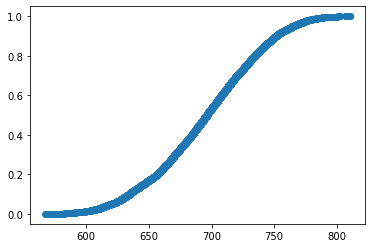

In [113]:
# simple visualization 
plt.scatter(sum_sort, np.cumsum(sum_sort)/sum(sum_sort))

In [114]:
# Average impact of the variables on the score
df_score.mean()

loan_amount                29.565035
interest_rate              29.371344
own_car                    29.435128
own_house                  29.335451
income_type                29.878433
education_type             30.171594
family_status              29.402393
housing_type               29.414122
region_population_ratio    29.365667
days_birth                 29.516169
days_employed              29.553307
days_registration          29.767897
mobile_number              29.336818
phone_number               29.579312
email                      29.337293
days_phone_change          29.889632
occupation_type            29.446395
EXT2                       36.371276
EXT3                       35.509730
EXT4                       29.336612
EXT5                       29.729211
EXT6                       29.336818
EXT7                       29.365640
dtype: float64

In [115]:
fig = go.Figure()

for i in np.arange(5, 101, 10):
    df_score = score_func(df_logit, df_logit.shape[1], ic, target_odds=i)
    sum_sort = np.sort(np.sum(df_score, axis=1))

    fig.add_trace(go.Scatter(x=sum_sort, y=np.cumsum(sum_sort)/sum(sum_sort), mode='lines', name=f"target_odds={i}"))

fig.show()

## To get scores reffered below references
https://github.com/aviolante/sas-python-work/blob/master/machine_learning/scorecard_post/credit_scorecard_demo_public.ipynb

https://blogs.sas.com/content/subconsciousmusings/2019/01/18/building-credit-scorecards-using-statistical-methods-and-business-logic/

Data-driven approach to compute scores (Logistic Regression):
• The score contribution for variable 𝑗 for applicant 𝑖 can be computed as:


𝑆𝑐𝑜𝑟𝑒𝑖𝑗 = 𝑜𝑓𝑓𝑠𝑒𝑡/𝑝 + 𝑓𝑎𝑐𝑡𝑜𝑟 ∗ 𝑙𝑜𝑔𝑖𝑡 + (𝑖𝑛𝑡𝑒𝑟𝑐𝑒𝑝𝑡/p)

Where 𝑝 is defined as the number of parameters. The 𝑜𝑓𝑓𝑠𝑒𝑡 is defined by the target range, while
the 𝑙𝑜𝑔𝑖𝑡 is based on the applicant variables and model coefficients.

• 𝑜𝑓𝑓𝑠𝑒𝑡 = 𝑡𝑎𝑟𝑔𝑒𝑡 𝑠𝑐𝑜𝑟𝑒 − 𝑓𝑎𝑐𝑡𝑜𝑟 ∗ ln(𝑡𝑎𝑟𝑔𝑒𝑡 𝑜𝑑𝑑𝑠)
• 𝑓𝑎𝑐𝑡𝑜𝑟 = 𝑝𝑑𝑜 ∗ log(2)
• Points to double the odds (pdo)

In [116]:
coefficients = pd.concat([pd.DataFrame(X_train[columns].columns),pd.DataFrame(np.transpose(logfit.coef_))], axis = 1)
coefficients.columns = ['Feature','Coef']
coefficients = coefficients.set_index('Feature')
    
scorecard_train = X_train[coefficients.index].apply(lambda x: x*coefficients['Coef'].T,axis=1)

scorecard_train['logit'] = scorecard_train[list(scorecard_train.columns)].sum(axis=1)

## Score card:

target_score = 850
target_odds = 50
pts_double_odds = 20

factor = pts_double_odds/np.log(2)
offset = target_score - factor * np.log(target_odds)

scorecard_train['score'] = offset + factor * scorecard_train['logit']

In [117]:
scorecard_train.head()

,loan_amount,interest_rate,own_car,own_house,income_type,education_type,family_status,housing_type,region_population_ratio,days_birth,...,days_phone_change,occupation_type,EXT2,EXT3,EXT4,EXT5,EXT6,EXT7,logit,score
15446,0.062833,0.011338,0.078121,-0.023125,0.135556,0.122249,-0.027957,-0.029838,0.000728,-0.011335,...,0.127945,-0.052749,-1.171255,0.029493,0.000007,0.085048,-8.129812e-12,-0.011076,-0.468654,723.600376
6053,0.062833,-0.017270,0.078121,0.010876,0.135556,-0.520923,-0.027957,-0.029838,0.010939,-0.011335,...,0.127945,-0.028002,-1.171255,-0.564084,0.000007,0.085048,-8.129812e-12,-0.011076,-1.791893,685.419783
7268,-0.041743,0.011338,0.078121,0.010876,0.135556,0.122249,-0.027957,0.003120,0.010939,-0.049638,...,0.127945,0.045736,0.665471,-1.251038,0.000007,0.085048,-8.129812e-12,-0.011076,-0.350287,727.015730
7400,-0.041743,0.011338,0.078121,0.010876,-0.354158,0.122249,-0.027957,-0.029838,0.000728,-0.073459,...,-0.050399,-0.052749,-0.151511,-0.564084,0.000007,0.085048,-8.129812e-12,-0.011076,-1.006355,708.085615
206,-0.228745,-0.055984,0.078121,-0.023125,-0.099467,-0.520923,-0.027957,-0.029838,-0.008858,0.033887,...,0.127945,0.045736,-0.151511,0.029493,0.000007,-0.382498,-8.129812e-12,-0.011076,-1.205335,702.344271


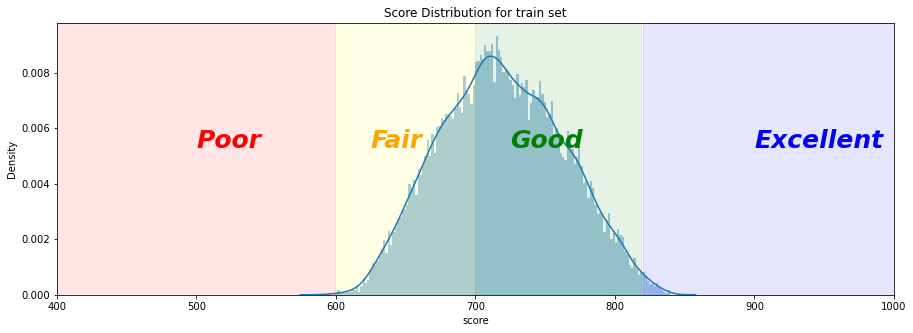

In [118]:
# Plotting the Scores for Train set

f, axes = plt.subplots(figsize=(15,5))
plt.xlim(400,1000)
sns.distplot(scorecard_train['score'], bins = 150)
plt.axvspan(400,599, alpha=0.1, color='red')
plt.axvspan(600,699, alpha=0.1, color='yellow')
plt.axvspan(700,819, alpha=0.1, color='green')
plt.axvspan(820,1200, alpha=0.1, color='blue')
plt.text(500, 0.0053, 'Poor', color='red', fontweight='bold', style='italic', fontsize=25)
plt.text(625, 0.0053, 'Fair', color='orange', fontweight='bold', style='italic', fontsize=25)
plt.text(725, 0.0053, 'Good', color='green', fontweight='bold', style='italic', fontsize=25)
plt.text(900, 0.0053, 'Excellent', color='blue', fontweight='bold', style='italic', fontsize=25)
plt.title('Score Distribution for train set')
plt.show()

In [119]:
coefficients = pd.concat([pd.DataFrame(X_test[columns].columns),pd.DataFrame(np.transpose(logfit.coef_))], axis = 1)
coefficients.columns = ['Feature','Coef']
coefficients = coefficients.set_index('Feature')
    
scorecard_test = X_test[coefficients.index].apply(lambda x: x*coefficients['Coef'].T,axis=1)

scorecard_test['logit'] = scorecard_test[list(scorecard_test.columns)].sum(axis=1)

## Score card:

target_score = 850
target_odds = 50
pts_double_odds = 20

factor = pts_double_odds/np.log(2)
offset = target_score - factor * np.log(target_odds)

scorecard_test['score'] = offset + factor * scorecard_test['logit']

In [120]:
scorecard_test.head()

,loan_amount,interest_rate,own_car,own_house,income_type,education_type,family_status,housing_type,region_population_ratio,days_birth,...,days_phone_change,occupation_type,EXT2,EXT3,EXT4,EXT5,EXT6,EXT7,logit,score
12471,0.062833,0.011338,0.078121,0.010876,0.135556,-0.520923,-0.027957,0.003120,0.010939,-0.049638,...,0.127945,-0.028002,-1.171255,0.029493,0.000007,0.085048,-8.129812e-12,-0.011076,-1.175053,703.218027
16353,-0.041743,-0.055984,0.078121,0.010876,-0.354158,0.122249,-0.027957,-0.029838,0.010939,-0.049638,...,-0.050399,-0.052749,-0.151511,-1.251038,0.000007,-0.382498,-8.129812e-12,-0.011076,-2.509923,664.701793
4941,0.062833,0.011338,-0.162920,0.010876,0.135556,0.122249,-0.027957,-0.029838,0.000728,0.033887,...,0.127945,-0.052749,0.665471,0.029493,0.000007,0.085048,-8.129812e-12,-0.011076,1.079415,768.268198
4331,-0.041743,0.011338,-0.162920,0.010876,0.135556,-0.520923,0.084767,-0.029838,-0.039907,0.085940,...,0.127945,-0.028002,-1.171255,0.029493,0.000007,0.085048,-8.129812e-12,-0.011076,-1.229332,701.651860
3581,-0.041743,0.011338,0.078121,-0.023125,0.135556,0.122249,-0.027957,-0.029838,0.010939,0.033887,...,0.127945,0.045736,-0.151511,-0.564084,0.000007,0.085048,-8.129812e-12,-0.011076,-0.334647,727.467005


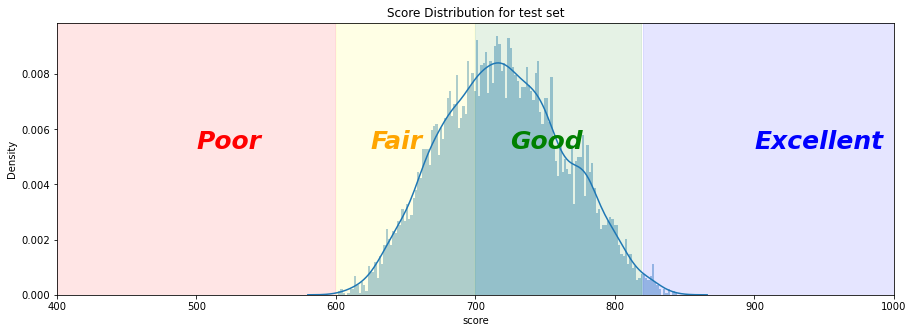

In [121]:
# Plotting the Scores for test set

f, axes = plt.subplots(figsize=(15,5))
plt.xlim(400,1000)
sns.distplot(scorecard_test['score'], bins = 150)
plt.axvspan(400,599, alpha=0.1, color='red')
plt.axvspan(600,699, alpha=0.1, color='yellow')
plt.axvspan(700,819, alpha=0.1, color='green')
plt.axvspan(820,1200, alpha=0.1, color='blue')
plt.text(500, 0.0053, 'Poor', color='red', fontweight='bold', style='italic', fontsize=25)
plt.text(625, 0.0053, 'Fair', color='orange', fontweight='bold', style='italic', fontsize=25)
plt.text(725, 0.0053, 'Good', color='green', fontweight='bold', style='italic', fontsize=25)
plt.text(900, 0.0053, 'Excellent', color='blue', fontweight='bold', style='italic', fontsize=25)
plt.title('Score Distribution for test set')
plt.show()

In [122]:
logreg = LogisticRegression().fit(final_woe[columns], final_woe['Default'])

In [123]:
coefficients = pd.concat([pd.DataFrame(final_woe[columns].columns),pd.DataFrame(np.transpose(logreg.coef_))], axis = 1)
coefficients.columns = ['Feature','Coef']
coefficients = coefficients.set_index('Feature')
    
scorecard_final = final_woe[columns][coefficients.index].apply(lambda x: x*coefficients['Coef'].T,axis=1)

scorecard_final['logit'] = scorecard_final[list(scorecard_final.columns)].sum(axis=1)

## Score card:
target_score = 850
target_odds = 50
pts_double_odds = 20

factor = pts_double_odds/np.log(2)
offset = target_score - factor * np.log(target_odds)

scorecard_final['score'] = offset + factor * scorecard_final['logit']

In [124]:
scorecard_final.score.min()

590.4723307716614

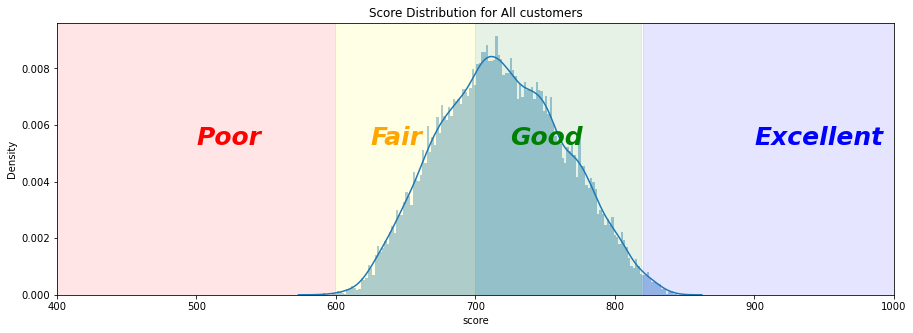

In [127]:
# Plotting the Scores for test set
f, axes = plt.subplots(figsize=(15,5))
plt.xlim(400,1000)
sns.distplot(scorecard_final['score'], bins = 150)
plt.axvspan(400,599, alpha=0.1, color='red')
plt.axvspan(600,699, alpha=0.1, color='yellow')
plt.axvspan(700,819, alpha=0.1, color='green')
plt.axvspan(820,1200, alpha=0.1, color='blue')
plt.text(500, 0.0053, 'Poor', color='red', fontweight='bold', style='italic', fontsize=25)
plt.text(625, 0.0053, 'Fair', color='orange', fontweight='bold', style='italic', fontsize=25)
plt.text(725, 0.0053, 'Good', color='green', fontweight='bold', style='italic', fontsize=25)
plt.text(900, 0.0053, 'Excellent', color='blue', fontweight='bold', style='italic', fontsize=25)
plt.title('Score Distribution for All customers')
plt.show()

In [128]:
scorecard_final.head()

,loan_amount,interest_rate,own_car,own_house,income_type,education_type,family_status,housing_type,region_population_ratio,days_birth,...,days_phone_change,occupation_type,EXT2,EXT3,EXT4,EXT5,EXT6,EXT7,logit,score
0,0.070534,0.022197,-0.153253,-0.033366,-0.092184,0.12814,-0.017362,-0.035189,0.001473,0.031204,...,0.132085,0.062704,-0.151714,1.037542,0.000007,-0.364650,-1.039989e-09,-0.010476,0.974762,765.248573
1,0.070534,0.022197,0.073486,0.015692,0.125630,0.12814,-0.017362,0.003680,-0.017928,0.031204,...,-0.349217,0.062704,0.666362,-1.274936,0.000007,0.081079,-1.039989e-09,-0.010476,-0.147050,732.879914
2,0.070534,0.022197,-0.153253,-0.033366,0.125630,0.12814,0.052643,-0.035189,-0.017928,0.031204,...,-0.204842,0.062704,-1.172823,1.037542,0.000007,0.081079,-1.039989e-09,-0.010476,0.208424,743.136714
3,0.070534,0.022197,-0.153253,-0.033366,0.125630,0.12814,-0.017362,-0.035189,0.022139,0.031204,...,-0.204842,0.062704,0.666362,-1.274936,0.000007,0.081079,-1.039989e-09,-0.010476,-0.527387,721.905709
4,-0.256779,-0.033809,0.073486,-0.033366,-0.328224,0.12814,-0.017362,0.003680,0.022139,-0.045707,...,-0.052029,-0.072319,-0.151714,0.030056,0.000007,-0.364650,-1.039989e-09,-0.010476,-1.116887,704.896341


## Cost Sensitive
In classification problems, we often assume that every misclassification is equally bad. Sometimes, however, this isn’t true. Consider the example of trying to classify whether or not the customer is treated as default. There are two types of misclassifications: either we predict the customer is treated as default(false positive), or we predict the customer is treated as not default (false negative). Clearly the false negative is much more dangerous than the false positive — we might end up loosing money in the false positive case, but people might die in the false negative case. We call classification problems like this cost-sensitive. https://towardsdatascience.com/not-all-mistakes-are-created-equal-cost-sensitive-learning-96bbc92bab88

We can deal with this kind of false negatives by setting the thresholding. Here we are taking 75% threshold to avoid false negatives.

In [129]:
cols = ['total_income', 'loan_amount', 'term', 'interest_rate', 'nr_children', 'region_population_ratio', 
        'days_birth', 'days_employed', 'days_registration', 'phone_number', 'email', 'days_phone_change', 'family_count', 'EXT2', 
        'EXT3', 'EXT4', 'EXT5', 'EXT6', 'EXT7', 'Default']

accept = accept[cols]
# reject = reject[[i for i in cols if i != "Default"]]

# drop missing values
accept = accept.dropna().reset_index(drop=True)
# reject = reject.dropna().reset_index(drop=True)

# train test split
X = accept[accept.columns[~accept.columns.isin(['Default'])]]
y = accept['Default']

#Split data in train (60%), test (40%)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, stratify = y, random_state=42)

#Split test in test (20%), validation (20%)
X_test, X_valid, y_test, y_valid = train_test_split(X_test, y_test, test_size=0.5, stratify = y_test, random_state=42)

#Reset Index 
X_train = X_train.reset_index(drop=True)
X_valid = X_valid.reset_index(drop=True)
X_test = X_test.reset_index(drop=True)

y_train = np.array(y_train)
y_valid = np.array(y_valid)
y_test = np.array(y_test)

In [130]:
# Annuity
def A(am, ir_c, n):
    return am * (ir_c*(1+ir_c)**n) / ((1+ir_c)**n - 1)

# Present Value
def PV(A, ir_rf, n):
    return A * (1-1/((1+ir_rf)**n)) / ir_rf

# Future Value
def FV(am, ir, n):
    return am * (1+ir)**n

In [131]:
def cost_FP(am, n, ir_c, ir_rf=0.015):
    return PV(A(am,ir_c,n),ir_rf,n) - am

def cost_FN(am, lgd=0.75):
    return am*lgd

In [132]:
# compute cost matrix
# transform months -> years

cm_train = pd.DataFrame()
cm_train["cFP"] = cost_FP(X_train["loan_amount"], X_train["term"]/12, X_train["interest_rate"]/100)
cm_train["cFN"] = cost_FN(X_train["loan_amount"])
cm_train["cTP"] = 0.0
cm_train["cTN"] = 0.0

cm_valid = pd.DataFrame()
cm_valid["cFP"] = cost_FP(X_valid["loan_amount"], X_valid["term"]/12, X_valid["interest_rate"]/100)
cm_valid["cFN"] = cost_FN(X_valid["loan_amount"])
cm_valid["cTP"] = 0.0
cm_valid["cTN"] = 0.0

cm_test = pd.DataFrame()
cm_test["cFP"] = cost_FP(X_test["loan_amount"], X_test["term"]/12, X_test["interest_rate"]/100)
cm_test["cFN"] = cost_FN(X_test["loan_amount"])
cm_test["cTP"] = 0.0
cm_test["cTN"] = 0.0

In [133]:
def total_cost(true, pred, cTP, cFN, cFP, cTN):
    return true*(pred*cTP+(1-pred)*cFN)+(1-true)*(pred*cFP+(1-pred)*cTN)

In [134]:
# Average cost
weights_avg_cost = {0:1, 1:np.mean(cm_train["cFN"] / cm_train["cFP"])}
print("Avg. cost:", weights_avg_cost)

# Inverse class distribution
c0, c1 = np.bincount(y_train)
weights_inv = {0:1,1:c0/c1}
print("Inv. class distribution:", weights_inv)

Avg. cost: {0: 1, 1: 29.962776216254632}
Inv. class distribution: {0: 1, 1: 10.70241850683491}


In [135]:
# evaluation metrics
def eval_metrics(proba, true, cm, t=0.5):
    proba = np.asarray(proba)
    true = np.asarray(true, dtype=int)
    pred = np.array(proba > t, dtype=int) # probability threshold

    auc = roc_auc_score(true, proba)
    f1 = f1_score(true, pred)
    cost = np.sum(total_cost(true, pred, **cm))

    return {
        'AUC': auc,
        'F1': f1,
        "Cost": cost,
    }

In [136]:
def run_GridSearch(name, data, model, param_grid, **kwargs):
    # save results
    metrics = kwargs.get("metrics", defaultdict(dict))

    #grid search parameters in grid_values
    #scoring is based on roc_auc -> outcome of gs is best model from grid search
    gs = GridSearchCV(model, param_grid = param_grid, scoring = kwargs.get("scoring", 'roc_auc'), cv=kwargs.get("cv", 3), refit=kwargs.get("refit", True))
    gs.fit(data["X_train"], data["y_train"])
    
    # predict
    proba_train   = gs.predict_proba(data["X_train"])[:,1]
    proba_valid   = gs.predict_proba(data["X_valid"])[:,1]

    # evaluate
    metrics[name]["train"] = eval_metrics(proba_train,data["y_train"],data["cm_train"])
    metrics[name]["valid"] = eval_metrics(proba_valid,data["y_valid"],data["cm_valid"])

    # prints
    if kwargs.get("print", True):
        print(f"{name}: {gs.best_params_}")
        for key, val in metrics[name].items():
            print(f"{key}: ", "\t".join([f"{k}: {v:.4f}" for k,v in val.items()]))

        cmtx = pd.DataFrame(
        confusion_matrix(data["y_valid"], np.round(proba_valid)), 
        index=['true:no', 'true:yes'], 
        columns=['pred:no', 'pred:yes'])

        print(cmtx)
    
    return gs, metrics

In [137]:
#Setup Grid search for logistic regression model
logistic = LogisticRegression(random_state=42)
rf = RandomForestClassifier(random_state=42)

models = {"logistic":logistic, "rf":rf}

# grid search values 
grid_values = {
                "logistic":{
                    "solver":["liblinear"],
                    'penalty': ['l1', 'l2'],
                    'C':[0.25, 0.5, 1, 3], 
                    "max_iter":[200,300],
                    "class_weight": ["balanced"] # can be extended to custom class weights
                },
                "rf":{
                    "max_depth":np.arange(2,11,1),
                    "class_weight": ["balanced"] # can be extended to custom class weights
                }
            }

In [138]:
data_temp = {
    "X_train":X_train,
    "y_train":y_train,
    "X_valid":X_valid,
    "y_valid":y_valid,
    "cm_train":cm_train,
    "cm_valid":cm_valid,
}

model_dict = defaultdict(dict)
metric_dict = defaultdict(dict)

#loop through models in models dictionary
for name, model in models.items():
    model_dict[name], metric_dict = run_GridSearch(name=name, data=data_temp, model=model, param_grid=grid_values[name], metrics=metric_dict)

logistic: {'C': 0.5, 'class_weight': 'balanced', 'max_iter': 200, 'penalty': 'l1', 'solver': 'liblinear'}
train:  AUC: 0.7404	F1: 0.2664	Cost: 208344895.1844
valid:  AUC: 0.7145	F1: 0.2485	Cost: 74385434.8253
          pred:no  pred:yes
true:no      2272      1121
true:yes      113       204
rf: {'class_weight': 'balanced', 'max_depth': 4}
train:  AUC: 0.7772	F1: 0.2943	Cost: 187911279.1963
valid:  AUC: 0.7122	F1: 0.2502	Cost: 77398736.1399
          pred:no  pred:yes
true:no      2346      1047
true:yes      122       195


In [139]:
# save performance validation
EVAL = metric_dict.copy()

# evaluate on test set
# Note: I did not ask for this in the exercises
EVAL["logistic"]["test"] = eval_metrics(model_dict["logistic"].predict_proba(X_test)[:,1], y_test, cm_test)
EVAL["rf"]["test"] = eval_metrics(model_dict["rf"].predict_proba(X_test)[:,1], y_test, cm_test)

In [140]:
def tune_threshold(true, proba, cm):
    thresholds = np.arange(0, 1, 0.001)
    costs = [np.sum(total_cost(true, np.array(proba > t, dtype=int), **cm)) for t in thresholds]
    return thresholds, costs

In [141]:
# Logistic Regression

thresholds, costs = tune_threshold(y_train, model_dict["logistic"].predict_proba(X_train)[:,1], cm_train)

# best threshold
index = np.argmin(costs)
print(f"Threshold: {thresholds[index]:.3f}\tCost: {costs[index]:.0f}")

# evaluate cutoff on all data sets
EVAL["logistic+cutoff"]["train"] = eval_metrics(model_dict["logistic"].predict_proba(X_train)[:,1], y_train, cm_train, t=thresholds[np.argmin(costs)])
EVAL["logistic+cutoff"]["valid"] = eval_metrics(model_dict["logistic"].predict_proba(X_valid)[:,1], y_valid, cm_valid, t=thresholds[np.argmin(costs)])
EVAL["logistic+cutoff"]["test"] = eval_metrics(model_dict["logistic"].predict_proba(X_test)[:,1], y_test, cm_test, t=thresholds[np.argmin(costs)])
print(EVAL["logistic+cutoff"])

# Number of accepted applicants = pred:no = 78
cmtx = pd.DataFrame(
        confusion_matrix(y_valid, np.array(model_dict["logistic"].predict_proba(X_valid)[:,1] > thresholds[np.argmin(costs)], dtype=int)), 
        index=['true:no', 'true:yes'], 
        columns=['pred:no', 'pred:yes'])
print(cmtx)

Threshold: 0.342	Cost: 178176233
{'train': {'AUC': 0.74036792826903, 'F1': 0.2149484536082474, 'Cost': 178176232.6926872}, 'valid': {'AUC': 0.7145189437150711, 'F1': 0.20539730134932532, 'Cost': 62008861.21077065}, 'test': {'AUC': 0.7235038551257413, 'F1': 0.20976902688375618, 'Cost': 62102953.03635396}}
          pred:no  pred:yes
true:no      1316      2077
true:yes       43       274


In [142]:
# Plot cost for all cutoffs
fig = go.Figure(data=go.Scatter(x=thresholds, y=costs))
fig.add_hline(y=np.min(costs), line_dash="dot", line_color="black")
fig.add_vline(x=thresholds[np.argmin(costs)], line_dash="dot", line_color="black")
fig.update_layout(
    title="Logistic Regression",
    xaxis_title="Threshold",
    yaxis_title="Cost"
)
fig.show()

In [143]:
# Random Forest 

thresholds, costs = tune_threshold(y_train, model_dict["rf"].predict_proba(X_train)[:,1], cm_train)

# best threshold
index = np.argmin(costs)
print(f"Threshold: {thresholds[index]:.3f}\tCost: {costs[index]:.0f}")

# evaluate cutoff on all data sets
EVAL["rf+cutoff"]["train"] = eval_metrics(model_dict["rf"].predict_proba(X_train)[:,1], y_train, cm_train, t=thresholds[np.argmin(costs)])
EVAL["rf+cutoff"]["valid"] = eval_metrics(model_dict["rf"].predict_proba(X_valid)[:,1], y_valid, cm_valid, t=thresholds[np.argmin(costs)])
EVAL["rf+cutoff"]["test"] = eval_metrics(model_dict["rf"].predict_proba(X_test)[:,1], y_test, cm_test, t=thresholds[np.argmin(costs)])
print(EVAL["rf+cutoff"])

# Number of accepted applicants = pred:no = 1394
cmtx = pd.DataFrame(
        confusion_matrix(y_valid, np.array(model_dict["rf"].predict_proba(X_valid)[:,1] > thresholds[np.argmin(costs)], dtype=int)), 
        index=['true:no', 'true:yes'], 
        columns=['pred:no', 'pred:yes'])
print(cmtx)

Threshold: 0.389	Cost: 157749339
{'train': {'AUC': 0.777201202403733, 'F1': 0.21884803614004267, 'Cost': 157749339.45014107}, 'valid': {'AUC': 0.7121620779838989, 'F1': 0.2055306427503737, 'Cost': 64193349.28393465}, 'test': {'AUC': 0.7210433244916002, 'F1': 0.20544918998527245, 'Cost': 61203130.69523108}}
          pred:no  pred:yes
true:no      1309      2084
true:yes       42       275


In [144]:
# Plot cost for all cutoffs
fig = go.Figure(data=go.Scatter(x=thresholds, y=costs))
fig.add_hline(y=np.min(costs), line_dash="dot", line_color="black")
fig.add_vline(x=thresholds[np.argmin(costs)], line_dash="dot", line_color="black")
fig.update_layout(
    title="Random Forest",
    xaxis_title="Threshold",
    yaxis_title="Cost"
)
fig.show()

In [145]:
# conda install -c conda-forge imbalanced-learn

from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

In [146]:
# setup sampling techniques

# SMOTE
sample_over = SMOTE(random_state=42)
X_train_over, y_train_over = sample_over.fit_resample(X_train, y_train)

# RandomUnderSampler
sample_under = RandomUnderSampler(random_state=42)
X_train_under, y_train_under = sample_under.fit_resample(X_train, y_train)

print(f"SMOTE: {np.bincount(y_train_over)}")
print(f"Random Undersampling: {np.bincount(y_train_under)}")

SMOTE: [10178 10178]
Random Undersampling: [951 951]


In [147]:
# compute new cost matrix
cm_train_over = pd.DataFrame()
cm_train_over["cFP"] = cost_FP(X_train_over["loan_amount"], X_train_over["term"]/12, X_train_over["interest_rate"]/100)
cm_train_over["cFN"] = cost_FN(X_train_over["loan_amount"])
cm_train_over["cTP"] = 0.0
cm_train_over["cTN"] = 0.0

data_temp = {
    "X_train":X_train_over,
    "y_train":y_train_over,
    "X_valid":X_valid,
    "y_valid":y_valid,
    "cm_train":cm_train_over,
    "cm_valid":cm_valid,
}

model_dict = defaultdict(dict)
metric_dict = defaultdict(dict)

#loop through models in models dictionary
for name, model in models.items():
    model_dict[name], metric_dict = run_GridSearch(name=name, data=data_temp, model=model, param_grid=grid_values[name], metrics=metric_dict)
    EVAL[name+"+over"]["train"] = eval_metrics(model_dict[name].predict_proba(X_train)[:,1], y_train, cm_train)
    EVAL[name+"+over"]["valid"] = eval_metrics(model_dict[name].predict_proba(X_valid)[:,1], y_valid, cm_valid)
    EVAL[name+"+over"]["test"] = eval_metrics(model_dict[name].predict_proba(X_test)[:,1], y_test, cm_test)

logistic: {'C': 0.5, 'class_weight': 'balanced', 'max_iter': 200, 'penalty': 'l1', 'solver': 'liblinear'}
train:  AUC: 0.8267	F1: 0.7557	Cost: 1141873112.4046
valid:  AUC: 0.6528	F1: 0.2177	Cost: 92921252.3692
          pred:no  pred:yes
true:no      2482       911
true:yes      167       150
rf: {'class_weight': 'balanced', 'max_depth': 10}
train:  AUC: 0.9657	F1: 0.9124	Cost: 345094815.4397
valid:  AUC: 0.6705	F1: 0.1991	Cost: 111014095.5858
          pred:no  pred:yes
true:no      2914       479
true:yes      229        88


In [148]:
# compute new cost matrix
cm_train_under = pd.DataFrame()
cm_train_under["cFP"] = cost_FP(X_train_under["loan_amount"], X_train_under["term"]/12, X_train_under["interest_rate"]/100)
cm_train_under["cFN"] = cost_FN(X_train_under["loan_amount"])
cm_train_under["cTP"] = 0.0
cm_train_under["cTN"] = 0.0

data_temp = {
    "X_train":X_train_under,
    "y_train":y_train_under,
    "X_valid":X_valid,
    "y_valid":y_valid,
    "cm_train":cm_train_under,
    "cm_valid":cm_valid,
}

model_dict = defaultdict(dict)
metric_dict = defaultdict(dict)

#loop through models in models dictionary
for name, model in models.items():
    model_dict[name], metric_dict = run_GridSearch(name=name, data=data_temp, model=model, param_grid=grid_values[name], metrics=metric_dict)
    EVAL[name+"+under"]["train"] = eval_metrics(model_dict[name].predict_proba(X_train)[:,1], y_train, cm_train)
    EVAL[name+"+under"]["valid"] = eval_metrics(model_dict[name].predict_proba(X_valid)[:,1], y_valid, cm_valid)
    EVAL[name+"+under"]["test"] = eval_metrics(model_dict[name].predict_proba(X_test)[:,1], y_test, cm_test)

logistic: {'C': 0.5, 'class_weight': 'balanced', 'max_iter': 200, 'penalty': 'l1', 'solver': 'liblinear'}
train:  AUC: 0.7361	F1: 0.6638	Cost: 160170672.4051
valid:  AUC: 0.7147	F1: 0.2514	Cost: 74868214.7226
          pred:no  pred:yes
true:no      2305      1088
true:yes      115       202
rf: {'class_weight': 'balanced', 'max_depth': 6}
train:  AUC: 0.8720	F1: 0.7807	Cost: 108580139.0339
valid:  AUC: 0.7088	F1: 0.2436	Cost: 77161351.2913
          pred:no  pred:yes
true:no      2275      1118
true:yes      118       199


In [149]:
# Display full overview
overview = pd.DataFrame(pd.concat({k: pd.DataFrame(v) for k,v in EVAL.items()}, axis=1)).T

# convert cost to million
overview["Cost"] /= 1_000_000

overview

AUC        F1        Cost
logistic        train  0.740368  0.266443  208.344895
                valid  0.714519  0.248477   74.385435
                test   0.723504  0.262588   71.640153
rf              train  0.777201  0.294326  187.911279
                valid  0.712162  0.250160   77.398736
                test   0.721043  0.250000   79.745433
logistic+cutoff train  0.740368  0.214948  178.176233
                valid  0.714519  0.205397   62.008861
                test   0.723504  0.209769   62.102953
rf+cutoff       train  0.777201  0.218848  157.749339
                valid  0.712162  0.205531   64.193349
                test   0.721043  0.205449   61.203131
logistic+over   train  0.676914  0.238037  258.459084
                valid  0.652831  0.217707   92.921252
                test   0.675716  0.233164   87.715911
rf+over         train  0.885592  0.432473  188.207799
                valid  0.670514  0.199095  111.014096
                test   0.667205  0.192799  112.980266
logistic+under  train  0.738251  0.261925  214.269248
                valid  0.714684  0.251400   74.868215
                test   0.720385  0.259067   74.235319
rf+under        train  0.816105  0.309930  160.569446
                valid  0.708816  0.243574   77.161351
                test   0.717082  0.258385   73.254905

In [150]:
# LR + cutoff tuning performs best on cost metric
overview.iloc[overview.index.get_level_values(1) == "test",:].sort_values("Cost", ascending=True)

,,AUC,F1,Cost
rf+cutoff,test,0.721043,0.205449,61.203131
logistic+cutoff,test,0.723504,0.209769,62.102953
logistic,test,0.723504,0.262588,71.640153
rf+under,test,0.717082,0.258385,73.254905
logistic+under,test,0.720385,0.259067,74.235319
rf,test,0.721043,0.250000,79.745433
logistic+over,test,0.675716,0.233164,87.715911
rf+over,test,0.667205,0.192799,112.980266


In [151]:
data_temp = {
    "X_train":X_train,
    "y_train":y_train,
    "X_valid":X_valid,
    "y_valid":y_valid,
    "cm_train":cm_train,
    "cm_valid":cm_valid,
}

name = "rf"
best_model, metrics = run_GridSearch(name=name, data=data_temp, model=models[name], param_grid=grid_values[name], print=False)

thresholds, costs_train = tune_threshold(y_train, best_model.predict_proba(X_train)[:,1], cm_train)
_, costs_test = tune_threshold(y_test, best_model.predict_proba(X_test)[:,1], cm_test)


# Display selected cutoff and true costs
fig = go.Figure(data=go.Scatter(x=thresholds, y=costs_test))
fig.add_vline(x=thresholds[np.argmin(costs_train)], line_dash="dot", line_color="black")
fig.update_layout(
    title="rf+cutoff",
    xaxis_title="Threshold",
    yaxis_title="Cost"
)
fig.show()

Random forest with the cut-off of 0.38 is the best model. If the bank incorporates random forest with the threshold of 0.38, it will costs the bank around 61.2M at most

## References
    Included the most references above, the additional references are below
    1. https://towardsdatascience.com/ - for understanding some uncleared concepts
    2. https://seaborn.pydata.org/introduction.html - for plots
    3. Professor's - study material